### Load and plot resident cell types

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import scvi
import seaborn as sns
import os,sys
import anndata
import scvi
os.chdir('/nfs/team205/ny1/ThymusSpatialAtlas/software/ImageSpot/')
import scvi_wrapper as sv
import anndata as ad

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100

from datetime import date
today = str(date.today())
sc.logging.print_header()
## Add this line so the text on pdf is correctly recognised!!!

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/pytorch_lightning/metrics/__init__.py:44: LightningDeprecationWarning: `pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package (https://github.com/PyTorchLightning/metrics) since v1.3 and will be removed in v1.5
  "`pytorch_lightning.metrics.*` module has been renamed to `torchmetrics.*` and split off to its own package"
Global seed set to 0


scanpy==1.8.2 anndata==0.8.0 umap==0.5.1 numpy==1.21.6 scipy==1.7.3 pandas==1.2.3 scikit-learn==1.0.2 statsmodels==0.13.5 python-igraph==0.9.10 louvain==0.7.1 pynndescent==0.5.2


In [2]:
import matplotlib.pyplot as plt
from matplotlib import font_manager
font_manager.fontManager.addfont("/nfs/team205/ny1/ThymusSpatialAtlas/software/Arial.ttf")
print(font_manager.findfont("Arial"))
from matplotlib import rcParams
plt.rcParams["font.sans-serif"] = ["Arial"]
plt.rcParams["pdf.fonttype"] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 300, vector_friendly = True, format = 'pdf')

/nfs/team205/ny1/ThymusSpatialAtlas/software/Arial.ttf


In [3]:
%cd /nfs/team205/vk8/projects/thymus_atlas/ThymusSpatialAtlas

/nfs/team205/ny1/ThymusSpatialAtlas


In [4]:
#model_folder = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure4/scvi_models/'
figures = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure_4_nat/figures/'
results = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure_4_nat/'

In [5]:
clean_folder = '/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/clean'

In [6]:
tec_mrkrs = ['FOXN1', 'ENPEP', 'LY75', # surface markers
 'CXCL12', 'CCL25', # homing
 'DLL4', 'IL7', 'KITLG', # commitment, proliferation and survival
'PSMB11', 'PRSS16', 'CD83', # processing machinery
'PAX9', 'SIX1', 'HLA-DQB1', 'KRT8', 'KRT18',   # cTEC markers
'DLK2', 'PDPN', 'ZBED2', 'IGFBP5', 'IGFBP6', 'MAOA', 'KRT5', 'KRT8',  'KRT15', 'CCL2',  #'CTGF', #mcTEC markers 
'EPCAM', 
'ASCL1', 'CCL21', 'KRT5', 'KRT14',
'AIRE', 'FEZF2', 'CDKN2A', 'AIRE', 'SLPI', 'CRIP1',
'SLPI', 'IVL', 'KRT1', 'KRT7',  'KRT10',  'CDKN2A', 'SPINK5',  \
'FOXI1',  'ASCL3', 'CFTR', 'CLCNKB', #ionocytes
'SOX9', 'POU2F3', 'DCLK1', 'IL25', # thymic tuft cells
'PLCB2', 'TRPM5', 'GNB3', 'GNG13', # thymic tuft cells, taste signalling pathway
'BEX1', 'NEUROD1', #neuro TEC all
'OLIG1', 'OLIG2', 'NEUROG1', 'NEUROD4', 
'PCP4', 'FOXJ1',  # cilliated cells
'CHRNA1', 'MYOG', 'TTN']

In [7]:
major_mrkrs = ['PTPRC', 'CD3G', 
               'HOXA9', 
               'HES1', #DN
               'RORC', #DP
               'CCR9',
              'PDCD1', #CD8aa
              'CD8A', 'CD8B', 
              'CD4', 'CD40LG', 
              'CRTAM', 'ANXA1', #memory
             'FOXP3', 'DHRS3', 
               'TRDC', #gama-delta 
              'EOMES', 'KLRD1', # NK cells
              'TNFSF11', # ILC
              'CD19', 'VPREB1', # pre-pro B cells
              'IGHD', 'IGHA1', 'IGHG1', 
              'CLEC9A', 'CLEC10A', 
              'LAMP3', 
             'LILRA4','S100A9', 'C1QA', 'TPSB2', 'ITGA2B', 'GYPA', 
              'PDGFRA', 'COLEC11', 'FBN1', 
              'RGS5', 'CDH5', 
               'LYVE1', 'EPCAM', 'PSMB11', 'DLK2', 'KRT14', 
               'CCL19', 'AIRE', 'KRT1', 'POU2F3',
               'MYOD1', 'NEUROG1']

In [8]:
melano_tec = ['CAMP', 'AIRE', 'PMCH','MUC4','CXCL17','KRT10','KLK10']
ctec = {'pan-cTEC':['PSMB11', 'LY75', 'CCL25', 'HLA-DRA'],
        'cTEC\nsubtypes':['DLL4', 'TP53AIP1', 'TBATA']}
mctec = {'mcTEC':['DLK2','IGFBP5', 'IGFBP6','CCN2', 'CCL2',
              'KRT15', 'ITGA6', 'MKI67']}
mtec = {'pan-mTEC': ['EPCAM'],
        'mTECI': ['ASCL1','CCL21'],
        'mTECII': ['AIRE', 'FEZF2','CRIP1'], 
        'mTECIII':['SLPI', 'IVL', 'KRT10','CDKN2A'],
        'pan-neuro TEC': ['BEX1', 'NEUROD1'],
        'neuroTEC': ['NEUROG1', 'NEUROD4'], 
        'cilliated TEC': ['PCP4', 'FOXJ1'], 
        'myoTEC':['CHRNA1', 'MYOG', 'TTN'],
        'ionocytes':['FOXI1', 'CFTR'],
        'tuft cells':['POU2F3','PLCB2', 'TRPM5']}
mhc1 = ['HLA-A', 'HLA-B', 'HLA-C', 'HLA-E', 'HLA-F', 'HLA-G']
mhc2 = ['HLA-DMA', 'HLA-DMB', 'HLA-DOA', 'HLA-DOB', 'HLA-DPA1','HLA-DPB1',  'HLA-DQA1', 'HLA-DQA2',
 'HLA-DQB1', 'HLA-DQB1-AS1','HLA-DQB2', 'HLA-DRA', 'HLA-DRB1', 'HLA-DRB5', ]

In [9]:
def run_scvi2(adata, batch_hv="age_group", batch_scvi="sample", \
             cat_cov_scvi=["DonorID", "10X_version", "Sex", "Age_group"], cont_cov_scvi=["percent_mito"], \
             include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
             exclude_vdjgenes = True, remove_cite = False, hvg = 3000, max_epochs = 350, vae_name="", **kwargs):
    adata_scvi = sc.AnnData(X=adata.layers['counts'].copy(), obs=adata.obs.copy(), var=adata.var.copy())
    #adata_scvi = adata_scvi[:,0:-150] # remove cite genes
    # adata_scvi.layers["counts"] = adata_scvi.X.copy()
    # sc.pp.normalize_total(adata_scvi, target_sum=1e4)
    # sc.pp.log1p(adata_scvi)
    # keep full dimension safe
    #    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=10000, layer="counts",\
    #                                batch_key="Age_group")
    if remove_cite:
        print('removing CITEseq genes pre SCVI')
        adata_scvi = adata_scvi[:,~adata_scvi.var['cite']].copy() # remove cite genes
    gene_list = adata_scvi.var_names.tolist()
    if exclude_cc_genes:
        cell_cycle_genes = [x.strip() for x in open('/nfs/team205/vk8/processed_data/regev_lab_cell_cycle_genes.txt')]
        [gene_list.remove(i) for i in cell_cycle_genes if i in gene_list]
    if exclude_mt_genes:
        mt_genes = adata.var_names[adata.var_names.str.startswith('MT-')]
        [gene_list.remove(i) for i in mt_genes if i in gene_list]
    if exclude_vdjgenes:
        import re
        [gene_list.remove(i) for i in gene_list if re.search('^TR[AB][VDJ]|^IG[HKL][VDJC]', i)]
    
    print('Removed excluded genes')
    adata_scvi = adata_scvi[:,gene_list].copy()
    sc.pp.highly_variable_genes(adata_scvi, flavor="seurat_v3", n_top_genes=hvg, batch_key=batch_hv)
    selected_genes = list(set(adata_scvi.var.loc[adata_scvi.var['highly_variable']].index.tolist() + include_genes))
    adata_scvi = adata_scvi[:, selected_genes].copy()
    print(f'Highly variable genes selected in total {adata_scvi.shape}')
    scvi.model.SCVI.setup_anndata(adata_scvi, batch_key=batch_scvi,
                                  categorical_covariate_keys=cat_cov_scvi,
                                  continuous_covariate_keys=cont_cov_scvi)
    scvi_kwargs = {k: v for k, v in kwargs.items() if k in scvi.model.SCVI.__init__.__code__.co_varnames}
    vae = scvi.model.SCVI(adata_scvi, **scvi_kwargs)
   # vae = scvi.model.SCVI(adata_scvi,n_layers=2, n_latent=30)
    train_kwargs = {k: v for k, v in kwargs.items() if k in vae.train.__code__.co_varnames}
    vae.train(**train_kwargs)
    # adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    #   adata_raw_scvi = adata.copy()
    print('scvi model trained')
    adata_scvi.obsm["X_scVI"] = vae.get_latent_representation()
    sc.pp.neighbors(adata_scvi, use_rep="X_scVI")
    sc.tl.leiden(adata_scvi, resolution = 1, key_added = "leiden_r1.0")
    sc.tl.leiden(adata_scvi, resolution = 1.2, key_added = "leiden_r1.2")
    sc.tl.leiden(adata_scvi, resolution = 1.4, key_added = "leiden_r1.4")
    sc.tl.leiden(adata_scvi, resolution = 1.6, key_added = "leiden_r1.6")
    #   sc.tl.umap(adata_scvi)
    sc.tl.umap(adata_scvi)
    print('DR and clustering performed')
    adata_raw_scvi = adata.copy()
    adata_raw_scvi.obsm['X_scVI'] = adata_scvi.obsm['X_scVI'].copy()
    adata_raw_scvi.obsm['X_umap'] = adata_scvi.obsm['X_umap'].copy()
    adata_raw_scvi.obsp = adata_scvi.obsp.copy()
    adata_raw_scvi.uns = adata_scvi.uns.copy()
    adata_raw_scvi.obs[["leiden_r1.0", "leiden_r1.2", "leiden_r1.4", "leiden_r1.6"]] = adata_scvi.obs[["leiden_r1.0", "leiden_r1.2", "leiden_r1.4", "leiden_r1.6"]].copy()
    sc.pp.normalize_total(adata_raw_scvi, target_sum = 1e4)
    sc.pp.log1p(adata_raw_scvi)
    sc.pl.umap(
        adata_raw_scvi,
        color=['cell_type_level_4'], legend_loc = "on data", legend_fontsize = 4, frameon=False,
        ncols=2,
    )
    sc.pl.umap(
        adata_raw_scvi,
        color=['age_group', 'sex', 'donor'], frameon = False, ncols = 2)
    sc.pl.umap(
        adata_raw_scvi,
        color=['study', 'chemistry_simple', 'doublet_score'])
    #cat_cov_str = "-".join(cat_cov_scvi)
    #    vae.save(f"/nfs/team205/vk8/scripts/scvi/Results/scvi_models/{vae_name}_scvi_batch{batch_scvi}_cat{cat_cov_str}_cont{cont_cov_scvi}_10000hvgenes_{today}", save_anndata = True)
    results = {}
    results['data'] = adata_raw_scvi
    results['vae'] = vae
    return (results)

## Load paediatric TECs 

In [16]:
clean_folder

'/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/clean'

In [10]:
adata_scvi_dbrm = sc.read('/nfs/team205/ny1/ThymusSpatialAtlas/Figure_1_nat/clean/TEC_scvi_dbrm_updated_2024-01-06.h5ad')
adata_pead = adata_scvi_dbrm[adata_scvi_dbrm.obs['age_group']!='fetal',:].copy()

In [ ]:
adata_pead_scvi_run = run_scvi2(adata_pead,  batch_hv="chemistry_simple", hvg = 5000, batch_scvi='sample', 
          cat_cov_scvi=['chemistry_simple','donor', 'sex'], cont_cov_scvi = None, include_genes=[], 
          exclude_cc_genes=True, exclude_vdjgenes=True, exclude_mt_genes = True, 
          n_layers=2, n_latent=30, max_epochs=350, batch_size=2000) 

Removed excluded genes
Highly variable genes selected in total (15807, 5000)
INFO     Using batches from adata.obs["sample"]                                              
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.X                                                             
INFO     Successfully registered anndata object containing 15807 cells, 5000 vars, 17        
         batches, 1 labels, and 0 proteins. Also registered 3 extra categorical covariates   
         and 0 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


GPU available: False, used: False
TPU available: False, using: 0 TPU cores


Epoch 1/400:   0%|          | 0/400 [00:00<?, ?it/s]

In [ ]:
adata_pead_scvi = adata_pead_scvi_run['data'].copy()

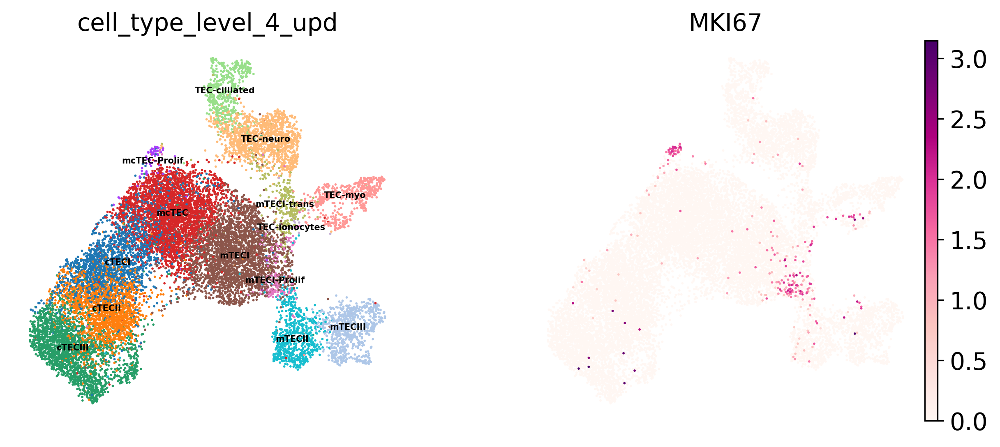

In [188]:
sc.pl.umap(adata_pead_scvi, color = ['cell_type_level_4_upd', 'MKI67'], legend_loc = "on data", legend_fontsize = 5, 
          frameon = False)

In [196]:
sc.tl.leiden(adata_pead_scvi, resolution = 0.1, restrict_to=['cell_type_level_4_upd', ['mcTEC']], key_added = 'cell_type_level_4_upd2')

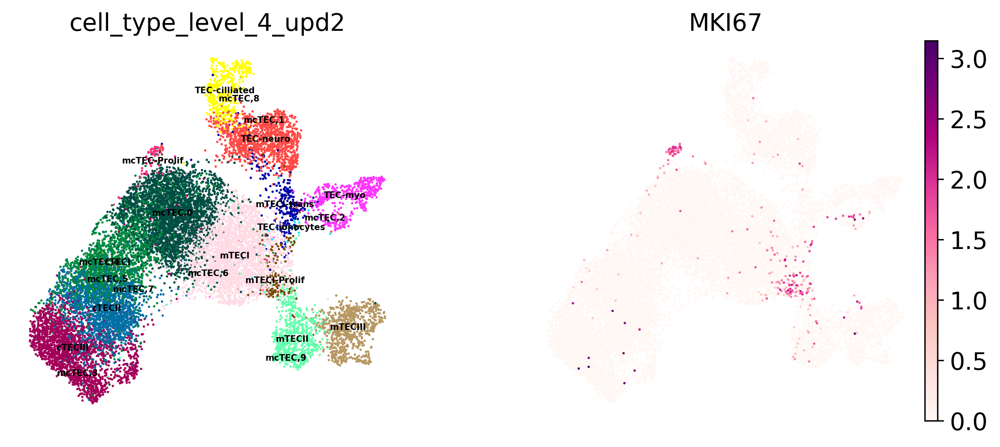

In [197]:
sc.pl.umap(adata_pead_scvi, color = ['cell_type_level_4_upd2', 'MKI67'], legend_loc = "on data", legend_fontsize = 5, 
          frameon = False)

In [190]:
mctec

{'mcTEC': ['DLK2',
  'IGFBP5',
  'IGFBP6',
  'CCN2',
  'CCL2',
  'KRT15',
  'ITGA6',
  'MKI67']}

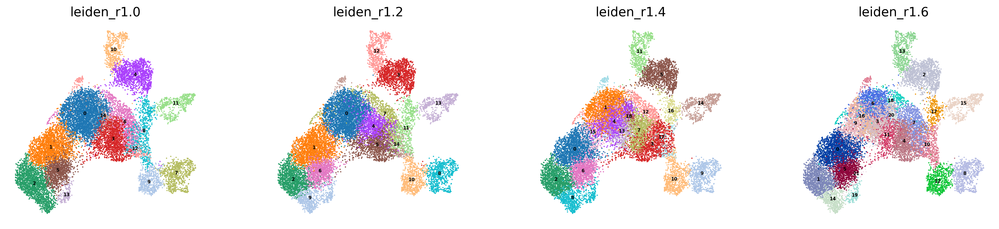

In [189]:
sc.pl.umap(adata_pead_scvi, color = ["leiden_r1.0", "leiden_r1.2", "leiden_r1.4", "leiden_r1.6"], 
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [200]:
adata_pead_scvi.obs.loc[adata_pead_scvi.obs['cell_type_level_4_upd']=='mcTEC',"leiden_r1.4"].value_counts()

1     1382
4      953
13     309
12     158
18      98
15      80
7       55
0       24
3       23
5       13
8        5
17       5
6        4
11       2
14       2
10       1
2        1
9        1
16       0
Name: leiden_r1.4, dtype: int64

In [205]:
adata_pead_scvi.obs.loc[adata_pead_scvi.obs['cell_type_level_4_upd']=='mcTEC',"leiden_r1.4"].value_counts(sort = False)

0       24
1     1382
2        1
3       23
4      953
5       13
6        4
7       55
8        5
9        1
10       1
11       2
12     158
13     309
14       2
15      80
16       0
17       5
18      98
Name: leiden_r1.4, dtype: int64

In [206]:
adata_pead_scvi.obs["leiden_r1.4"].value_counts(sort = False)

0     1738
1     1638
2     1395
3     1264
4     1255
5     1162
6     1009
7      947
8      737
9      731
10     681
11     592
12     584
13     517
14     502
15     387
16     292
17     232
18     144
Name: leiden_r1.4, dtype: int64

In [207]:
(adata_pead_scvi.obs.loc[adata_pead_scvi.obs['cell_type_level_4_upd']=='mcTEC',"leiden_r1.4"].value_counts(sort = False))/(adata_pead_scvi.obs["leiden_r1.4"].value_counts(sort = False))

0     0.013809
1     0.843712
2     0.000717
3     0.018196
4     0.759363
5     0.011188
6     0.003964
7     0.058078
8     0.006784
9     0.001368
10    0.001468
11    0.003378
12    0.270548
13    0.597679
14    0.003984
15    0.206718
16    0.000000
17    0.021552
18    0.680556
Name: leiden_r1.4, dtype: float64

In [210]:
def scvi_markers(vae, cluster, n_markers=5):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 1]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)

In [212]:
mrkrs_mcTEC = scvi_markers(adata_pead_scvi_run['vae'], cluster = "leiden_r1.4", n_markers = 8)

DE...: 100%|██████████| 19/19 [01:19<00:00,  4.21s/it]


In [ ]:
sc.pl.umap(adata_pead_scvi, color = ["leiden_r1.4"], groups = ['1', '4', '13', '18', '12'],
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [226]:
adata_pead_scvi.shape

(15807, 36601)

In [244]:
mrks_list = []
[mrks_list.extend(mrkrs_mcTEC['markers'][k]) for k in ('1', '4', '13', '18', '12')]

[None, None, None, None, None]

In [248]:
adata_pead_scvi

AnnData object with n_obs × n_vars = 15807 × 36601
    obs: 'n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group', 'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex', 'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'sex', 'doublet_score', 'predicted_doublet', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2', 'n_counts', 'barcode_sequence', 'backup_barcode', 'louvian_05', 'leiden_05', 'leiden_1', 'leiden_2', 'park_2020_cell_type', 'panfetal_2022_cell_type', 'cell_type_level_4', 'cell_type_level_3', 'cell_type_level_2', 'cell_type_level_1', 'cell_type_level_0', 'pseudotime_nhood_vdj', 'prob_CD8+T_nhood_vdj', 'prob_CD4+T_nhood_vdj', 'leiden_3', 'leiden_4', 'unannotated', 'pred_cell_type_level_4', 'pred_cell_type_level_4_uncertainties', 'undefined', 'RNA.weight', 'ADTdsb.weight', 'low_ADT', 'spt_CD4', 'spt_CD8', 'anno_CITE', 'c

In [ ]:
sc.pl.umap(adata_pead_scvi, color = mrks_list)

In [246]:
sc.pl.umap(adata_pead_scvi, color = mrks_list)

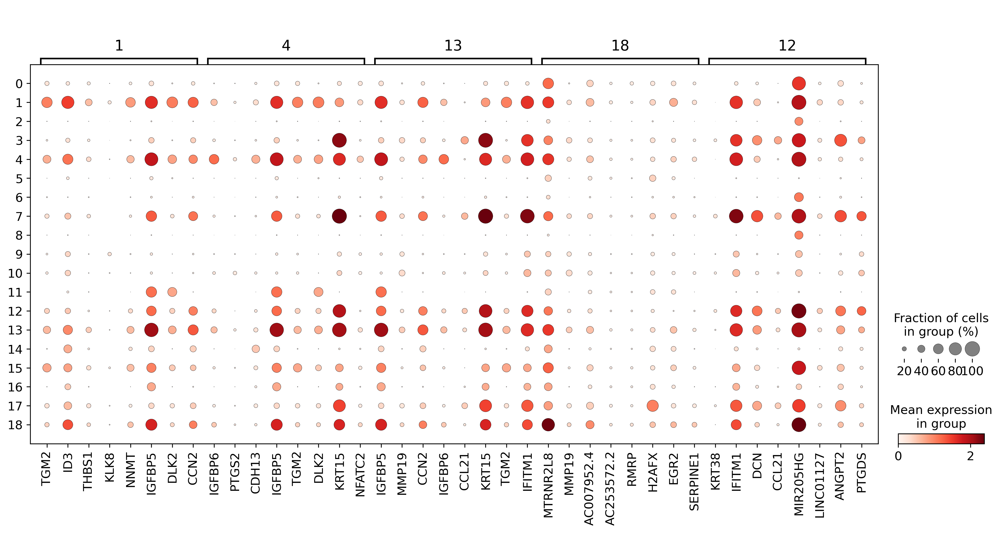

In [222]:
sc.pl.dotplot(adata_pead_scvi, var_names = {k: mrkrs_mcTEC['markers'][k] for k in ('1', '4', '13', '18', '12')},
              groupby = "leiden_r1.4")

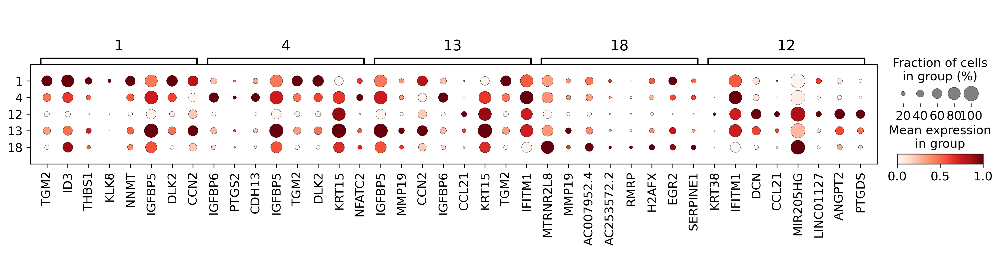

In [271]:
sc.pl.dotplot(adata_pead_scvi[adata_pead_scvi.obs["leiden_r1.4"].isin(['1', '4', '13', '18', '12']),:], var_names = {k: mrkrs_mcTEC['markers'][k] for k in ('1', '4', '13', '18', '12')},
              groupby = "leiden_r1.4", standard_scale = "var")

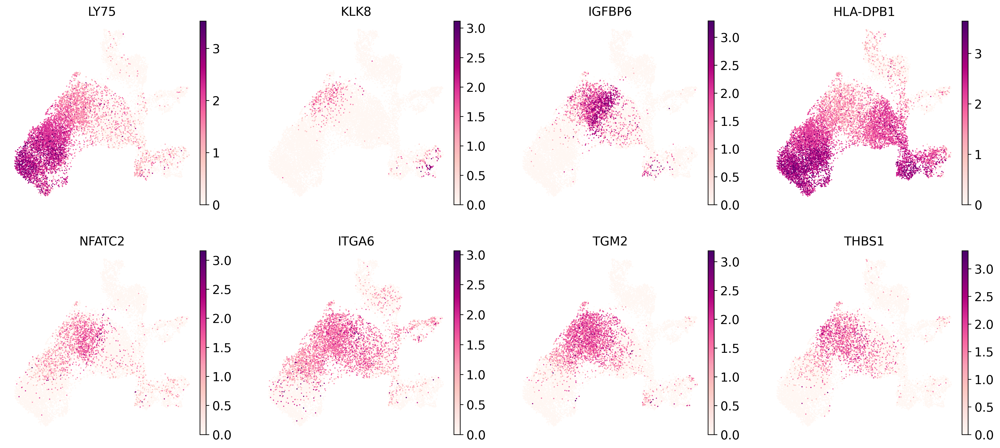

In [272]:
sc.pl.umap(adata_pead_scvi, color = ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6",
                                    "TGM2", "THBS1"], groups = ['1', '4', '13', '18', '12'],
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [ ]:
def scvi_markers(vae, cluster, n_markers=5):
    results = {}
    de_df = vae.differential_expression(
    groupby=cluster)
    de_df['cluster'] = [i.replace(" vs Rest","") for i in de_df['comparison']]
    de_df.head()
    markers = {}
    cats = vae.adata.obs[cluster].cat.categories
    for i, c in enumerate(cats):
        cid = "{} vs Rest".format(c)
        cell_type_df = de_df.loc[de_df.comparison == cid]
        cell_type_df = cell_type_df[cell_type_df.lfc_mean > 1]
        cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 2]
        cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]
        markers[c] = cell_type_df.index.tolist()[:n_markers]
    results['de_df'] = de_df
    results['markers'] = markers
    #print(results)
    return(results)

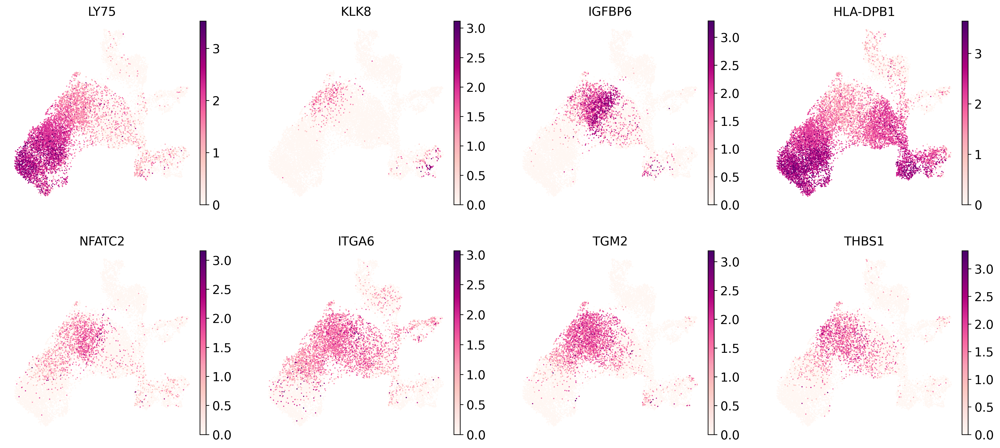

In [272]:
sc.pl.umap(adata_pead_scvi, color = [], 
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

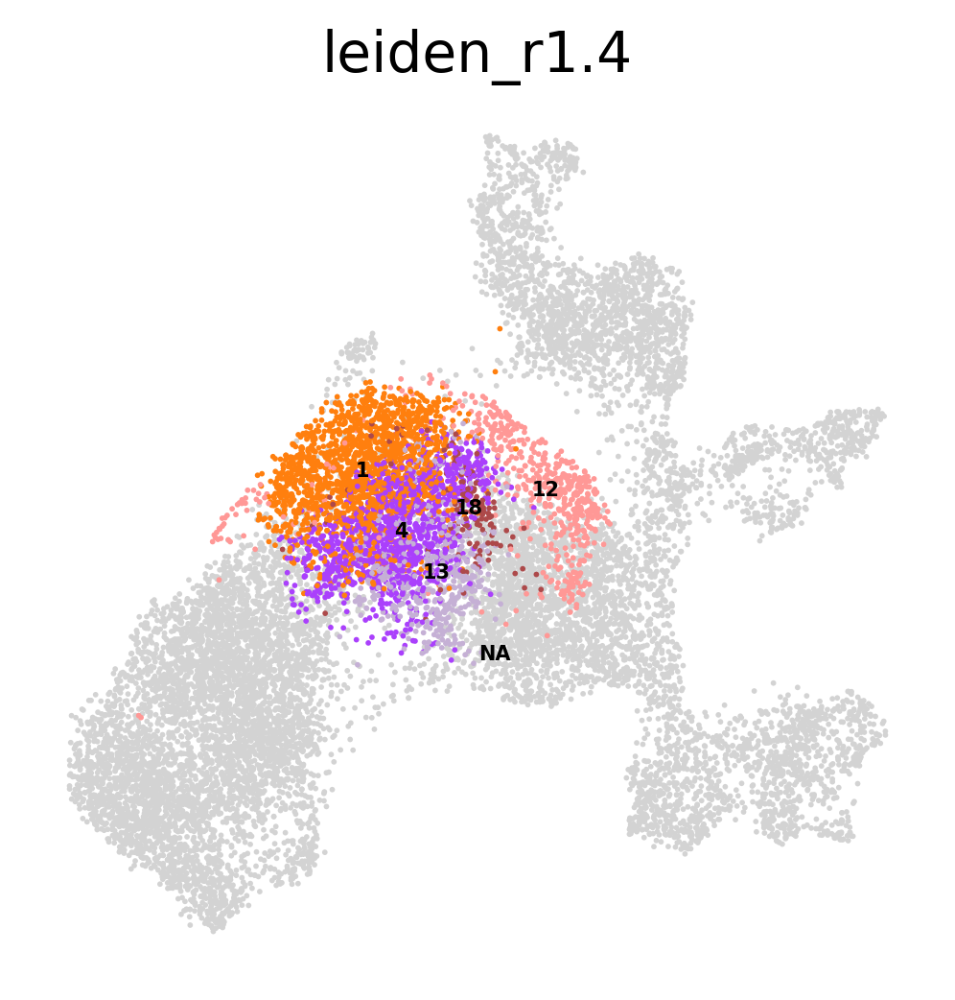

In [208]:
sc.pl.umap(adata_pead_scvi, color = ["leiden_r1.4"], groups = ['1', '4', '13', '18', '12'],
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [276]:
adata_pead_scvi.obs['cell_type_level_4_upd']

barcode
T07_TH_EPCAM_5GEX-CGAGCACGTTCCTCCA     mTECII
TA13072427-CTGATCCAGTACGCCC            mTECII
TA13072427-GCACATACAGCGTTCG            mTECII
TA13072428-ACAGCTATCTACGAGT           TEC-myo
GSM4466785-ACGATACAGTCTCGGC           cTECIII
                                       ...   
TA9260017-ATGCGATGTTTGTTTC              mTECI
TA9260017-ACGGAGAGTTGACGTT              mcTEC
TA9260017-CAACTAGCAATGTTGC              mcTEC
GSM4466785-ATGTGTGTCAAGGCTT           TEC-myo
TA12571164-TCGTAGAAGCTAACAA           cTECIII
Name: cell_type_level_4_upd, Length: 15807, dtype: category
Categories (14, object): ['cTECI', 'cTECII', 'cTECIII', 'mcTEC', ..., 'TEC-neuro', 'TEC-cilliated', 'TEC-myo', 'TEC-ionocytes']

In [277]:
adata_pead_scvi.obs['cell_type_level_4_upd2'] = adata_pead_scvi.obs.apply(lambda x:
                                                'mcTEC_cort' if x["leiden_r1.4"] == '1' else
                                                'mcTEC_cmj' if x["cell_type_level_4_upd"]=='mcTEC' else
                                                   x["cell_type_level_4_upd"], axis = 1)

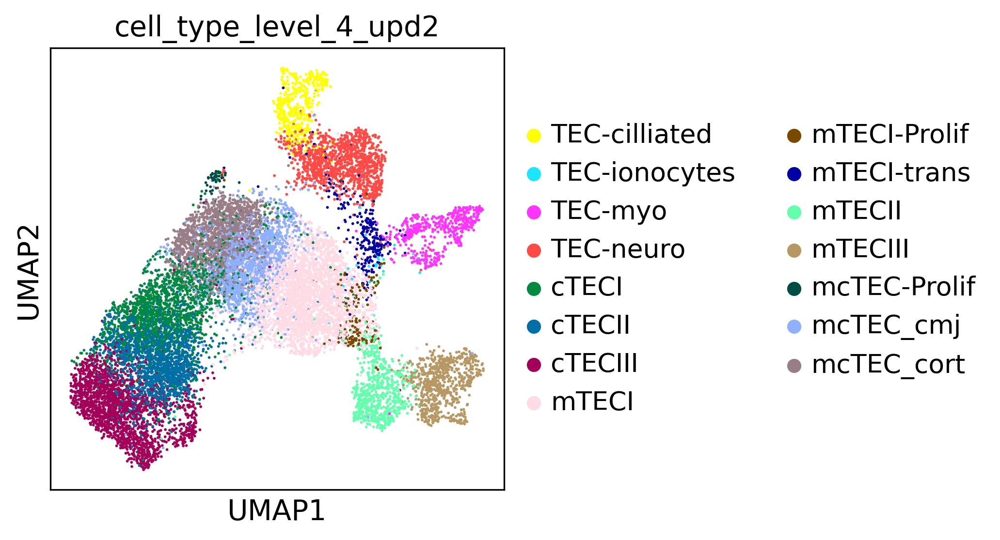

In [280]:
sc.pl.umap(adata_pead_scvi, color = ['cell_type_level_4_upd2'])

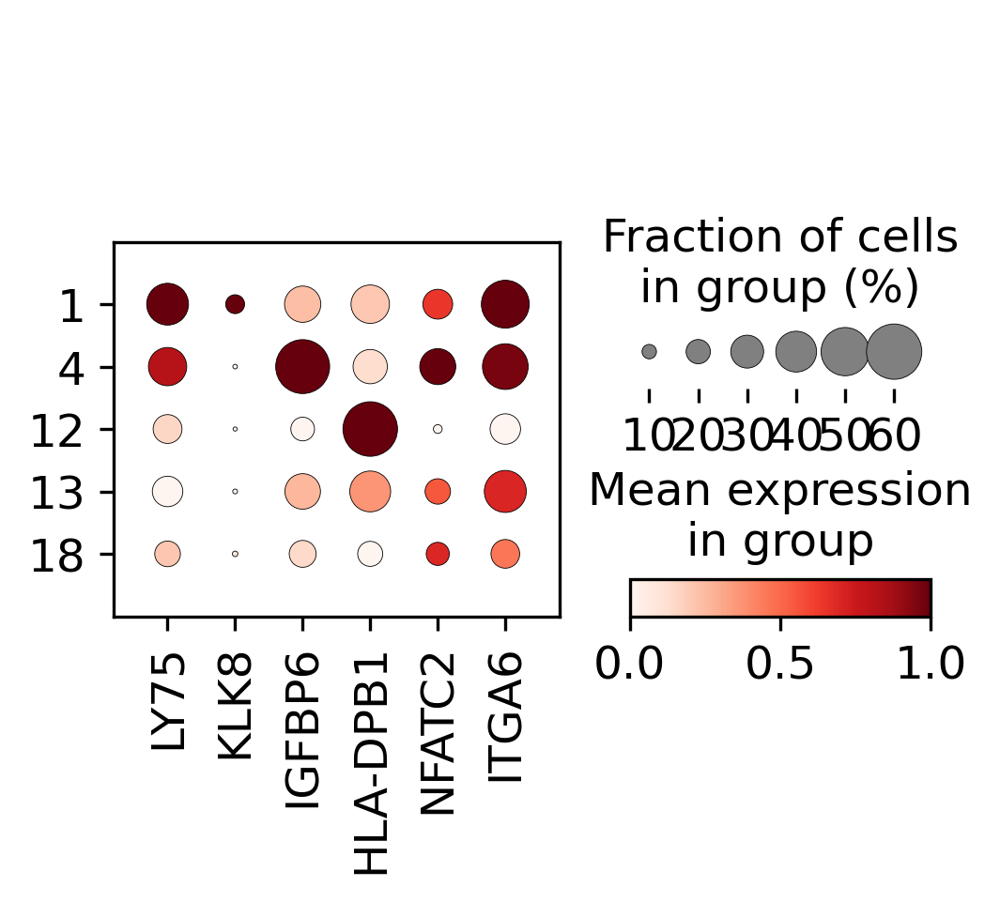

In [257]:
sc.pl.dotplot(adata_pead_scvi[adata_pead_scvi.obs["leiden_r1.4"].isin(['1', '4', '13', '18', '12']),], 
              var_names = ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"], 
              groupby = "leiden_r1.4", standard_scale = "var")

In [264]:
adata_pead_scvi.layers['counts'].data

array([ 2.,  1.,  7., ...,  8.,  4., 20.], dtype=float32)

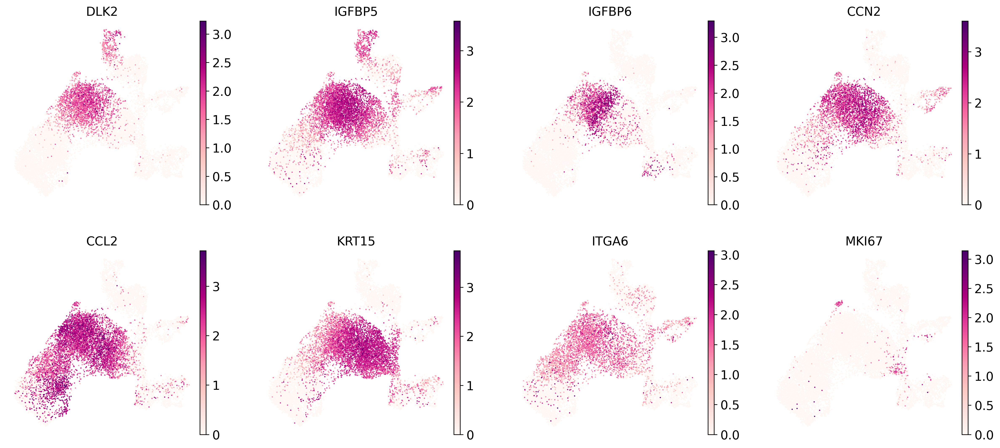

In [191]:
sc.pl.umap(adata_pead_scvi, color = ['DLK2',
  'IGFBP5',
  'IGFBP6',
  'CCN2',
  'CCL2',
  'KRT15',
  'ITGA6',
  'MKI67'], 
           legend_loc = "on data", legend_fontsize = 5, frameon = False)

In [281]:
adata_pead_scvi.write(f'{clean_folder}/TEC_pead_scvi_updated_{today}.h5ad')

## Re-load the data 

In [10]:
adata_paed_scvi = sc.read("Figure_1_nat/clean/TEC_pead_scvi_updated_2024-01-08.h5ad")

In [11]:
tec_stemnet = pd.read_csv('Figure_4_nat/TECs_stemnet.csv', index_col = 0)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3170: DtypeWarning: Columns (35) have mixed types.Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [12]:
len(set(tec_stemnet.index).intersection(set(adata_paed_scvi.obs_names)))

13105

In [13]:
len(set(tec_stemnet.index).difference(set(adata_paed_scvi.obs_names)))

0

In [14]:
upd_obs = pd.merge(adata_paed_scvi.obs, tec_stemnet[['TEC', 'potential_cTECI', 'potential_cTECII',
       'potential_cTECIII', 'potential_mTECI', 'potential_mTECII',
       'potential_mTECIII', 'potential_label', 'potential_cTECIvsmTECI',
       'potential_cTECIvsmTECI_categ']], how  = "left", left_index = True, right_index = True)

In [15]:
upd_obs.index.equals(adata_paed_scvi.obs_names)
adata_paed_scvi.obs = upd_obs.copy()

True

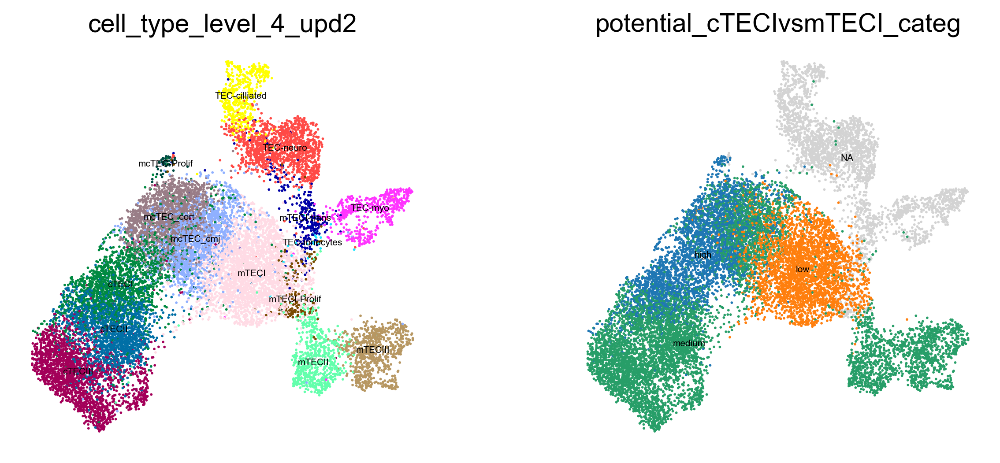

In [16]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd2', 'potential_cTECIvsmTECI_categ'], legend_loc = "on data", legend_fontsize = 5, 
          frameon = False)

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


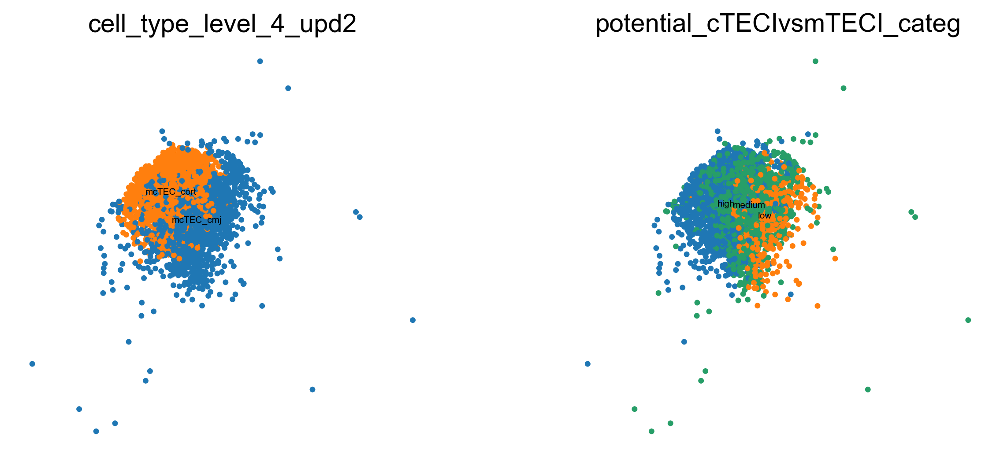

In [17]:
sc.pl.umap(adata_paed_scvi [adata_paed_scvi.obs['cell_type_level_4_upd'] == 'mcTEC',], color = ['cell_type_level_4_upd2', 'potential_cTECIvsmTECI_categ'], legend_loc = "on data", legend_fontsize = 5, 
          frameon = False)

In [18]:
pd.crosstab(index = adata_paed_scvi.obs['cell_type_level_4_upd2'], columns = adata_paed_scvi.obs['potential_cTECIvsmTECI_categ'])

potential_cTECIvsmTECI_categ,high,low,medium
cell_type_level_4_upd2,,,
cTECI,1522,5,256
cTECII,98,1,1515
cTECIII,13,2,2127
mTECI,9,2619,110
mTECII,0,15,656
mTECIII,0,0,745
mcTEC-Prolif,43,4,3
mcTEC_cmj,525,316,893
mcTEC_cort,1040,84,504


In [19]:
pd.crosstab(index = adata_paed_scvi.obs['cell_type_level_4_upd2'], columns = adata_paed_scvi.obs['TEC'])

TEC,cTEC,mTEC,mcTEC
cell_type_level_4_upd2,,,
cTECI,1783,0,0
cTECII,1614,0,0
cTECIII,2142,0,0
mTECI,0,2738,0
mTECII,0,671,0
mTECIII,0,745,0
mcTEC-Prolif,0,0,50
mcTEC_cmj,0,0,1734
mcTEC_cort,205,19,1404


In [20]:
adata_paed_scvi.obs.loc[(adata_paed_scvi.obs['cell_type_level_4_upd2'] == 'mcTEC_cort') &
                       (adata_paed_scvi.obs['cell_type_level_4_upd'] != 'mcTEC'), 'cell_type_level_4_upd']

barcode
GSM4466785-ACGATACAGTCTCGGC    cTECIII
GSM4466784-AGAATAGTCCTCTAGC      cTECI
GSM4466785-TCGCGAGCAGGTGCCT      cTECI
GSM4466785-GCTGCGATCGCGGATC      cTECI
GSM4466785-AAATGCCGTTAAGGGC      cTECI
                                ...   
TA13072429-AAAGATGCATGTAGTC      cTECI
TA13072429-TAGCCGGGTCCGTCAG      cTECI
TA13072429-CGATGTAAGAAACCTA      cTECI
TA9260017-CTGCGGACACAGAGGT       mTECI
GSM4466785-ATGTGTGTCAAGGCTT    TEC-myo
Name: cell_type_level_4_upd, Length: 256, dtype: category
Categories (14, object): ['cTECI', 'cTECII', 'cTECIII', 'mcTEC', ..., 'TEC-neuro', 'TEC-cilliated', 'TEC-myo', 'TEC-ionocytes']

In [21]:
adata_paed_scvi.obs['cell_type_level_4_upd'] = adata_paed_scvi.obs['cell_type_level_4_upd'].astype(str)
adata_paed_scvi.obs['cell_type_level_4_upd2'] = adata_paed_scvi.obs['cell_type_level_4_upd2'].astype(str)

In [22]:
adata_paed_scvi.obs.loc[(adata_paed_scvi.obs['cell_type_level_4_upd2'] == 'mcTEC_cort') &
                       (adata_paed_scvi.obs['cell_type_level_4_upd'] != 'mcTEC'), 'cell_type_level_4_upd2'] = adata_paed_scvi.obs.loc[(adata_paed_scvi.obs['cell_type_level_4_upd2'] == 'mcTEC_cort') & (adata_paed_scvi.obs['cell_type_level_4_upd'] != 'mcTEC'), 'cell_type_level_4_upd'].copy()

In [77]:
adata_paed_scvi.write(f"Figure_1_nat/clean/TEC_pead_scvi_updated_stemnet_{today}.h5ad")

In [79]:
adata_paed_scvi.obs.columns

Index(['n_genes', 'sample_barcode', 'batch', 'chemistry_simple', 'age_group',
       'age_numeric', 'sampleID_TCRab', 'path_TCRab', 'path_cellbender_gex',
       'study', 'study_group', 'sample', 'enrichment', 'donor', 'cite', 'sex',
       'doublet_score', 'predicted_doublet', 'n_genes_by_counts',
       'total_counts', 'total_counts_mt', 'pct_counts_mt', 'total_counts_ribo',
       'pct_counts_ribo', 'total_counts_hb', 'pct_counts_hb', 'percent_mt2',
       'n_counts', 'barcode_sequence', 'backup_barcode', 'louvian_05',
       'leiden_05', 'leiden_1', 'leiden_2', 'park_2020_cell_type',
       'panfetal_2022_cell_type', 'cell_type_level_4', 'cell_type_level_3',
       'cell_type_level_2', 'cell_type_level_1', 'cell_type_level_0',
       'pseudotime_nhood_vdj', 'prob_CD8+T_nhood_vdj', 'prob_CD4+T_nhood_vdj',
       'leiden_3', 'leiden_4', 'unannotated', 'pred_cell_type_level_4',
       'pred_cell_type_level_4_uncertainties', 'undefined', 'RNA.weight',
       'ADTdsb.weight', 'low_ADT',

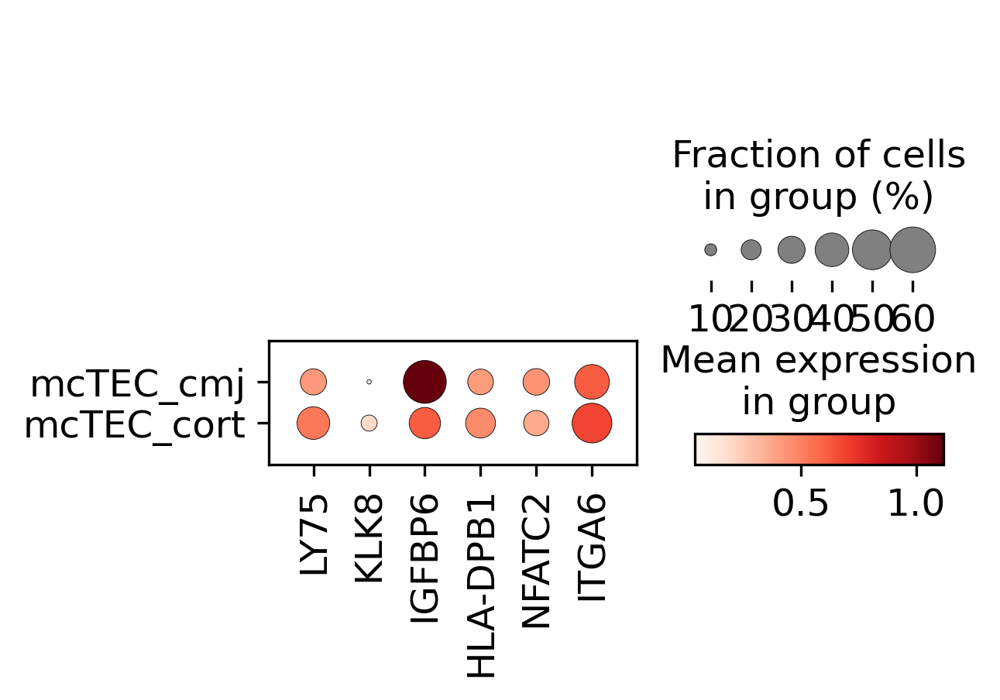

In [80]:
sc.pl.dotplot(adata_paed_scvi [adata_paed_scvi.obs['cell_type_level_4_upd'] == 'mcTEC',], 
              var_names = ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"], 
             groupby = 'cell_type_level_4_upd2')

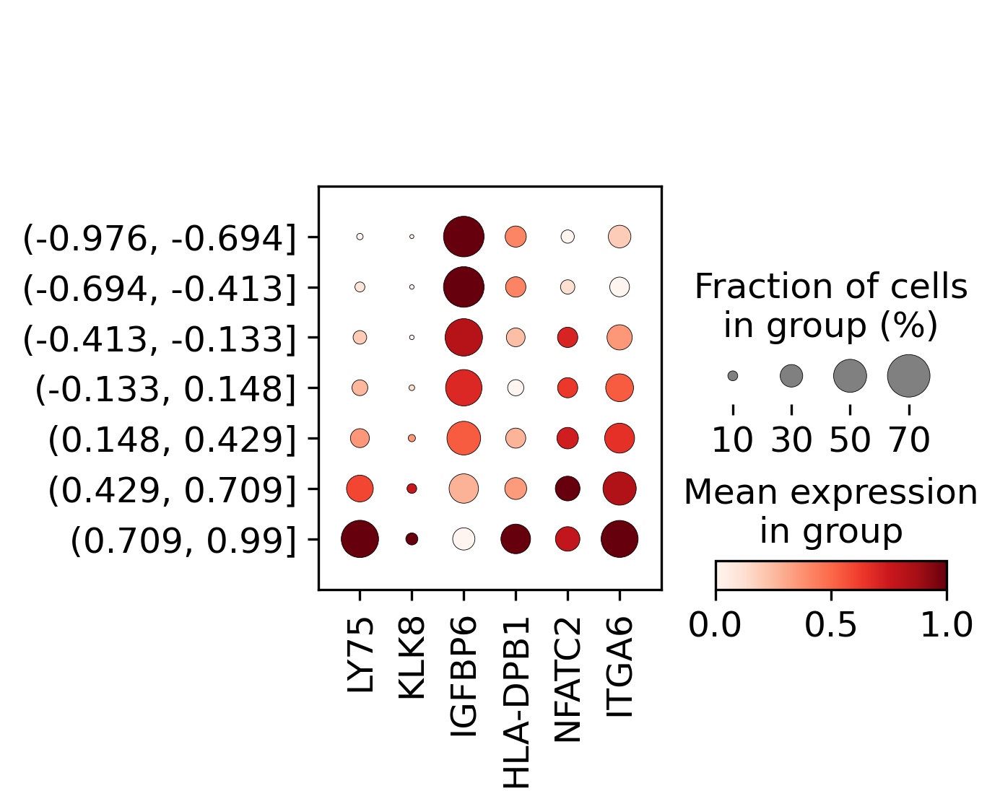

In [86]:
sc.pl.dotplot(adata_paed_scvi [adata_paed_scvi.obs['cell_type_level_4_upd'] == 'mcTEC',], 
              var_names = ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"], 
             groupby = 'potential_cTECIvsmTECI', standard_scale = "var")

In [84]:
adata_paed_scvi.obs['potential_cTECIvsmTECI_categ'].cat.reorder_categories(['low', 'medium', 'high'], inplace = True)

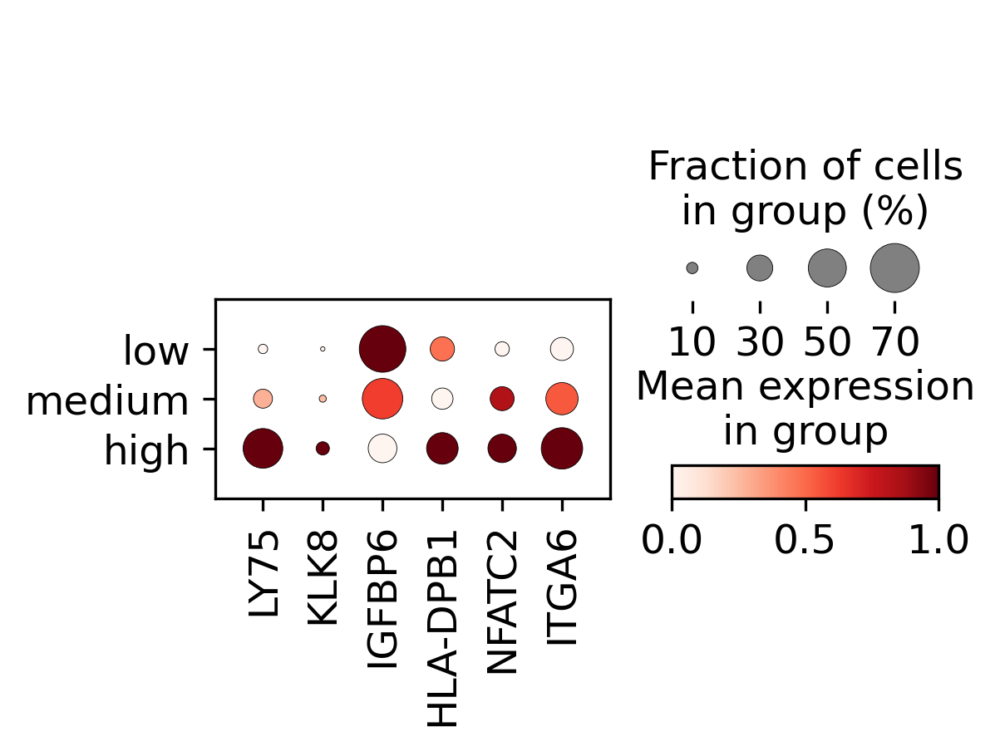

In [87]:
sc.pl.dotplot(adata_paed_scvi [adata_paed_scvi.obs['cell_type_level_4_upd'] == 'mcTEC',], 
              var_names = ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"], 
             groupby = 'potential_cTECIvsmTECI_categ', standard_scale = "var")

In [9]:
adata_paed_scvi = sc.read("Figure_1_nat/clean/TEC_pead_scvi_updated_stemnet_2024-01-23.h5ad")

In [12]:
adata_paed_scvi.obs['cell_type_level_4_upd'].cat.categories

Index(['TEC-cilliated', 'TEC-ionocytes', 'TEC-myo', 'TEC-neuro', 'cTECI',
       'cTECII', 'cTECIII', 'mTECI', 'mTECI-Prolif', 'mTECI-trans', 'mTECII',
       'mTECIII', 'mcTEC', 'mcTEC-Prolif'],
      dtype='object')

In [13]:
adata_paed_scvi.obs['potential_cTECIvsmTECI_categ'].cat.categories

Index(['high', 'low', 'medium'], dtype='object')

In [15]:
adata_paed_scvi.obs['cell_type_level_4_upd3'] = adata_paed_scvi.obs.apply(lambda x: 
                                            x['cell_type_level_4_upd'] if x['cell_type_level_4_upd']!= 'mcTEC' else
                                            'mcTEC_cTEChi' if x['potential_cTECIvsmTECI_categ']=='high' else
                                            'mcTEC_cTECme' if x['potential_cTECIvsmTECI_categ']=='medium' else 
                                            'mcTEC_cTEClo' if x['potential_cTECIvsmTECI_categ']=='low' else
                                             x['cell_type_level_4_upd'], axis = 1)

In [17]:
adata_paed_scvi.obs['cell_type_level_4_upd3'].value_counts()

mTECI            2756
cTECIII          2146
cTECI            1983
cTECII           1615
mcTEC_cTEChi     1375
mcTEC_cTECme     1355
TEC-neuro        1226
mTECIII           746
mTECII            671
TEC-myo           506
TEC-cilliated     478
mcTEC_cTEClo      386
mTECI-trans       297
mTECI-Prolif      164
mcTEC-Prolif       72
TEC-ionocytes      31
Name: cell_type_level_4_upd3, dtype: int64

In [19]:
adata_paed_scvi.obs['cell_type_level_4_upd'].value_counts()

mcTEC            3116
mTECI            2756
cTECIII          2146
cTECI            1983
cTECII           1615
TEC-neuro        1226
mTECIII           746
mTECII            671
TEC-myo           506
TEC-cilliated     478
mTECI-trans       297
mTECI-Prolif      164
mcTEC-Prolif       72
TEC-ionocytes      31
Name: cell_type_level_4_upd, dtype: int64

In [18]:
adata_paed_scvi.write("Figure_1_nat/clean/TEC_pead_scvi_updated_stemnet_2024-01-23.h5ad")

## Re-load the data v2

In [ ]:
adata_paed_scvi = sc.read("Figure_1_nat/clean/TEC_pead_scvi_updated_stemnet_2024-01-23.h5ad")

In [ ]:
adata_paed_scvi_subset = adata_paed_scvi[adata_paed_scvi.obs['cell_type_level_4_explore'].isin(['cTECI', 'cTECII',
       'cTECIII', 'mTECI','mTECII', 'mTECIII', 'mcTEC']),:].copy()

In [ ]:
adata_paed_scvi_subset.obs['cell_type_level_4_explore'].cat.reorder_categories(['cTECIII','cTECII', 'cTECI',
                                                                               'mcTEC', 'mTECI', 'mTECII', 'mTECIII'], inplace = True)

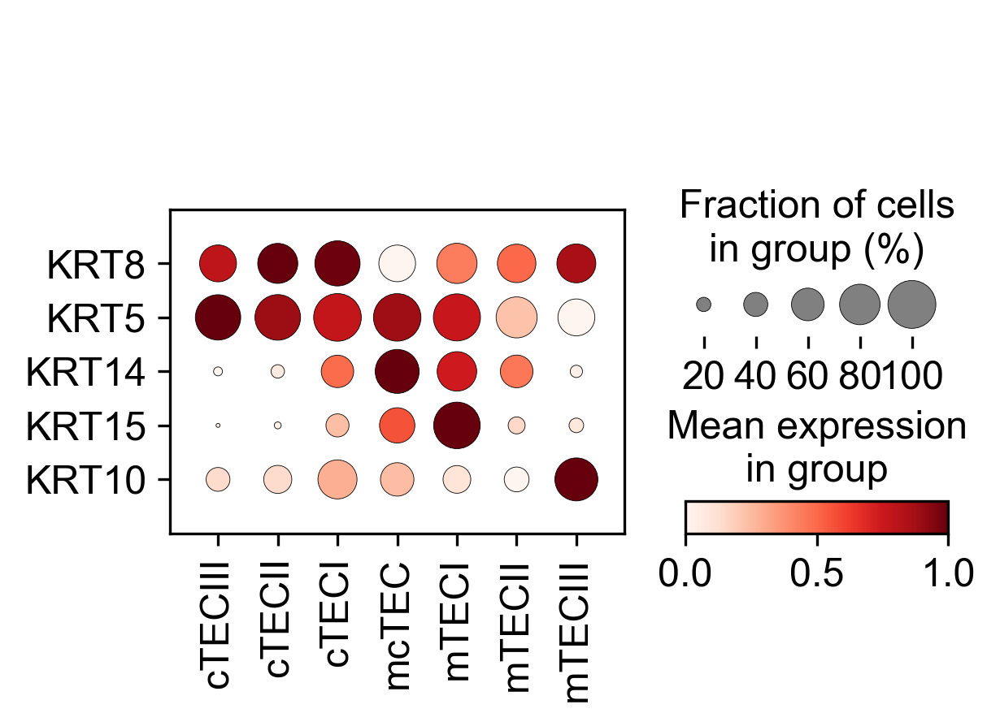

In [25]:
sc.pl.dotplot(adata_paed_scvi_subset, groupby = 'cell_type_level_4_explore', 
             var_names = ['KRT8', 'KRT5', 'KRT14', 'KRT15', 'KRT10'], standard_scale = 'var', swap_axes = True,
             save = "Keratins_fig4d_red_pal.pdf")

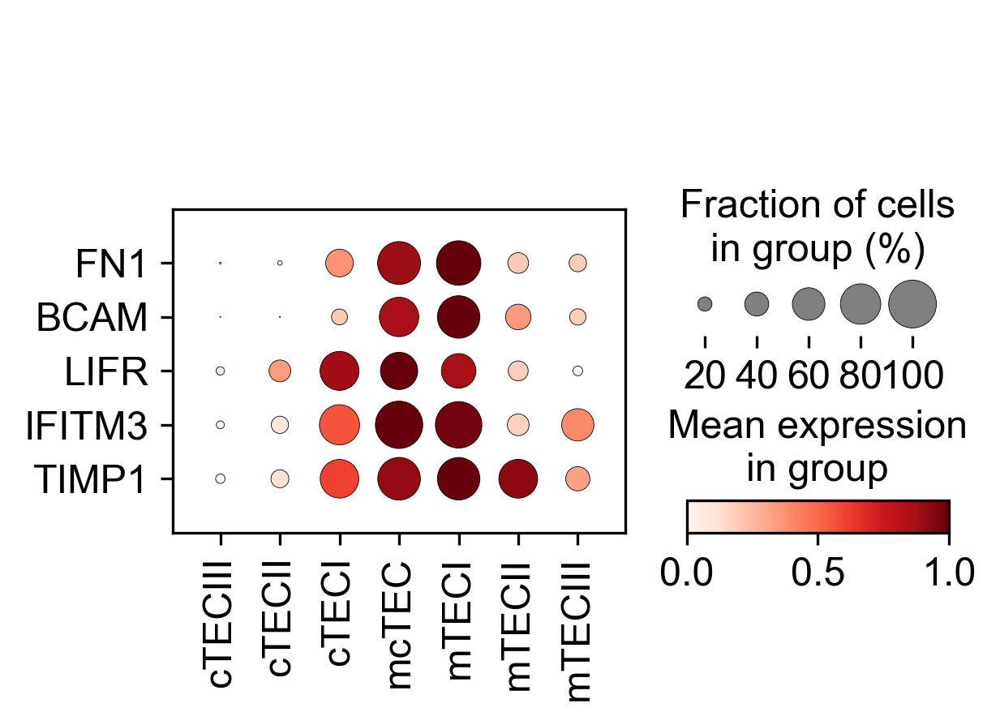

In [13]:
sc.pl.dotplot(adata_paed_scvi_subset, groupby = 'cell_type_level_4_explore', 
             var_names = ['FN1', 'BCAM', 'LIFR', 'IFITM3', 'TIMP1'], standard_scale = 'var', swap_axes = True)

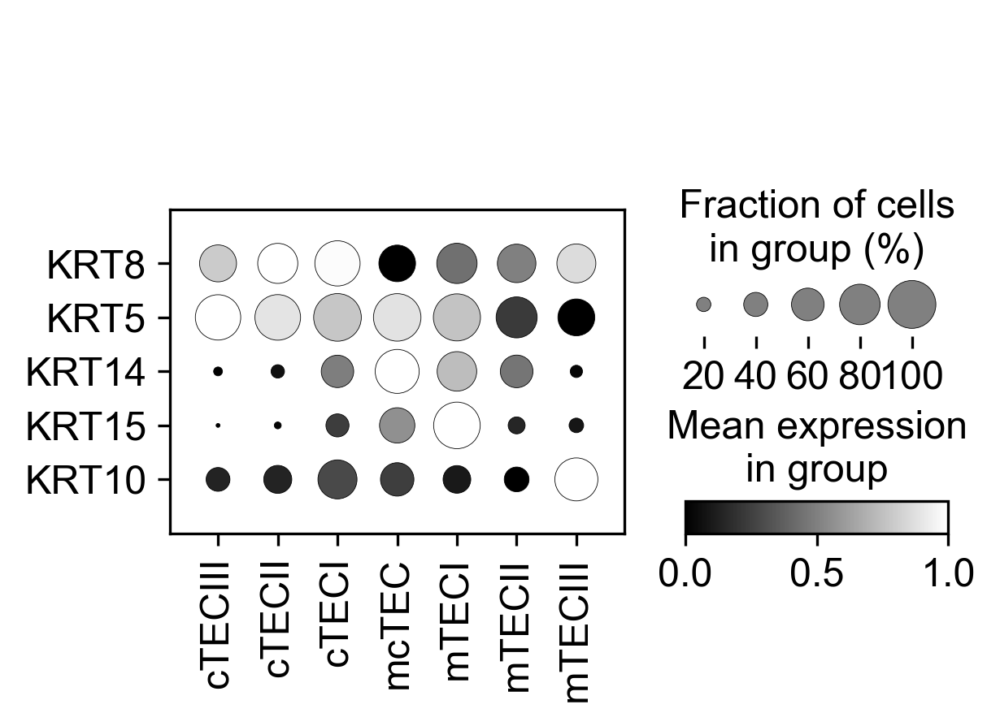

In [23]:
sc.pl.dotplot(adata_paed_scvi_subset, groupby = 'cell_type_level_4_explore', 
             var_names = ['KRT8', 'KRT5', 'KRT14', 'KRT15', 'KRT10'], standard_scale = 'var', swap_axes = True,
             cmap = "gist_gray", save = "Keratins_fig4d_gist_gray_pal.pdf")

adata_paed_scvi.obs['cell_type_level_4_upd3'] = adata_paed_scvi.obs['cell_type_level_4_upd3'].cat.rename_categories({'mcTEC_cTEChi': 'mcTEC_cTECI-primed', 
                                                        'mcTEC_cTECme': 'mcTEC_unprimed', 
                                                        'mcTEC_cTEClo': 'mcTEC_mTECI-primed'}).copy()

In [17]:
adata_paed_scvi.obs['cell_type_level_4_upd'].cat.categories

Index(['TEC-cilliated', 'TEC-ionocytes', 'TEC-myo', 'TEC-neuro', 'cTECI',
       'cTECII', 'cTECIII', 'mTECI', 'mTECI-Prolif', 'mTECI-trans', 'mTECII',
       'mTECIII', 'mcTEC', 'mcTEC-Prolif'],
      dtype='object')

In [ ]:
adata_paed_scvi.obs['cell_type_level_4_upd3'] = adata_paed_scvi.obs.apply(lambda x:
                                                'nan' if x['cell_type_level_4_upd'] not in ['mcTEC','mcTEC-Prolif'] else
                                                'cTECI_primed' if x['potential_cTECIvsmTECI_categ'] == 'high' else
                                                'unprimed' if x['potential_cTECIvsmTECI_categ'] == 'medium' else
                                                'mTECI_primed' if x['potential_cTECIvsmTECI_categ'] == 'low' else "leftover", axis = 1)

In [19]:
adata_paed_scvi.obs['cell_type_level_4_upd3'].value_counts()

nan             12619
cTECI_primed     1431
unprimed         1366
mTECI_primed      391
Name: cell_type_level_4_upd3, dtype: int64

In [20]:
adata_paed_scvi.obs['cell_type_level_4_explore'].cat.reorder_categories(['cTECIII', 'cTECII', 'cTECI', 'mcTEC', 'mcTEC-Prolif', 'mTECI','mTECII',
             'mTECIII', 'mTECI-trans','TEC-neuro','TEC-cilliated','TEC-myo', 'TEC-tuft'], inplace = True)

In [21]:
new_colors = ['#ffc47c',
 '#994c39',
 '#540103',
  '#ff7b55',
 '#df3a91',
 '#be023a',
 '#018de8',
 '#a74c56', 
 '#3f065a',
 '#cedc85',
 '#533cad',
 '#597000',
 '#eb71de']

In [22]:
adata_paed_scvi.uns['cell_type_level_4_explore_colors'] = new_colors

In [23]:
adata_paed_scvi.obs['cell_type_level_4_explore'].cat.categories

Index(['cTECIII', 'cTECII', 'cTECI', 'mcTEC', 'mcTEC-Prolif', 'mTECI',
       'mTECII', 'mTECIII', 'mTECI-trans', 'TEC-neuro', 'TEC-cilliated',
       'TEC-myo', 'TEC-tuft'],
      dtype='object')

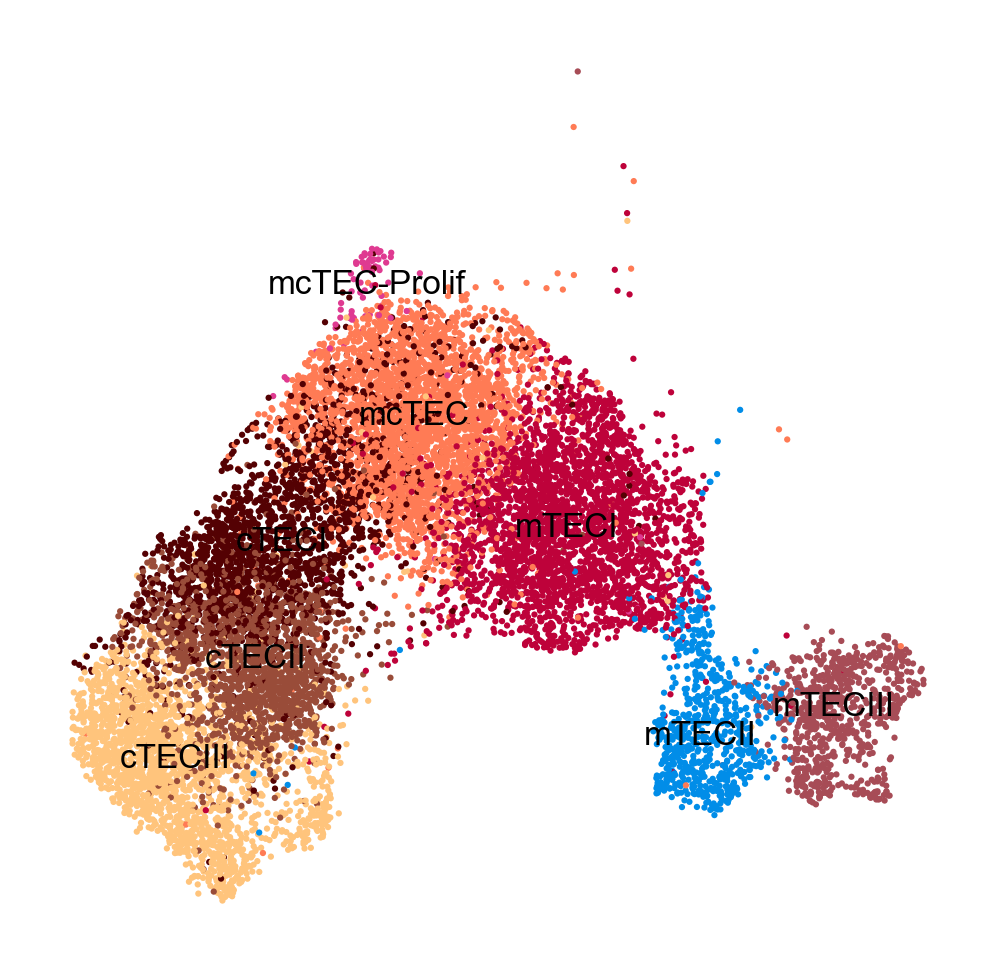

In [15]:
sc.pl.umap(adata_paed_scvi[~adata_paed_scvi.obs['cell_type_level_4_explore'].isin(['mTECI-trans', 'TEC-neuro', 'TEC-cilliated',
       'TEC-myo', 'TEC-tuft'])], color = ['cell_type_level_4_explore'], legend_loc = "on data", legend_fontsize = 8, 
           title = "", frameon = False, save = "TEC_paediatric_UMAP_mcTEC_Supl.pdf")

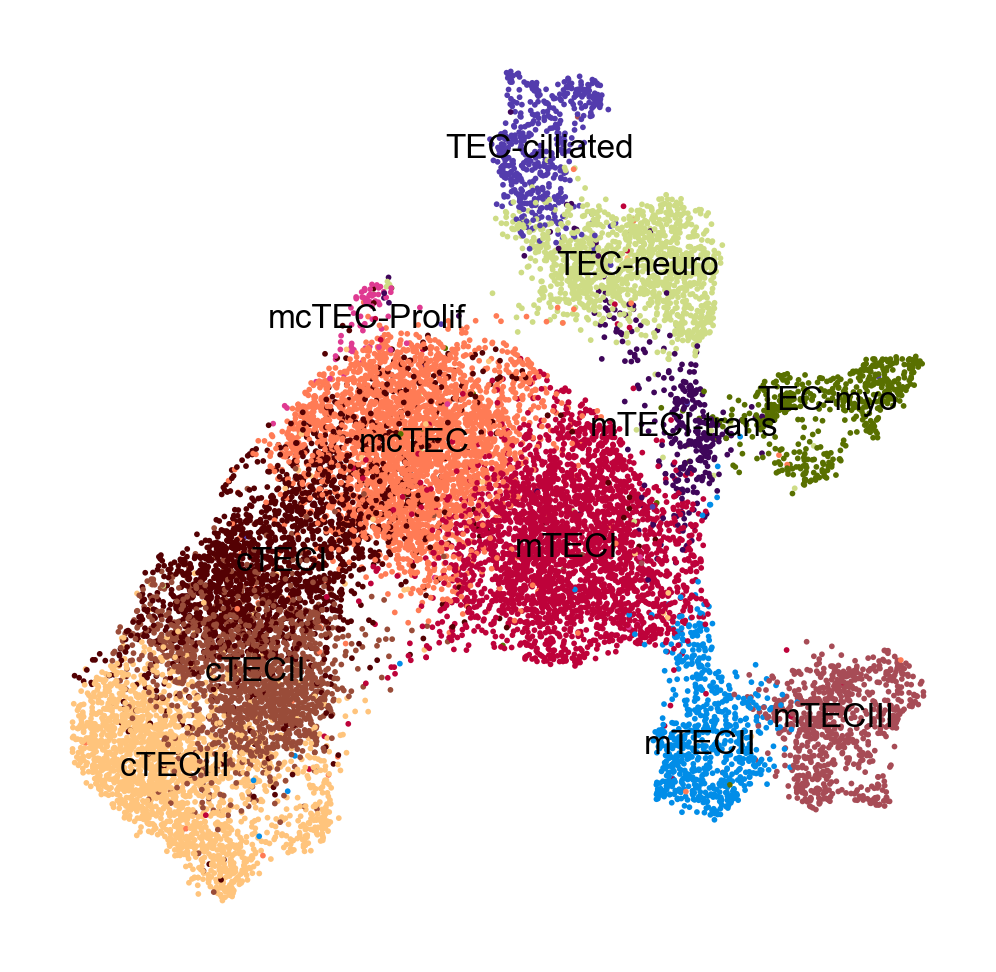

In [35]:
sc.pl.umap(adata_paed_scvi[adata_paed_scvi.obs['cell_type_level_4_explore']!='TEC-tuft'], color = ['cell_type_level_4_explore'], legend_loc = "on data", legend_fontsize = 8, 
           title = "", frameon = False, save = "TEC_paediatric_UMAP.pdf")

/nfs/team205/vk8/miniconda/envs/scvi-env/lib/python3.7/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


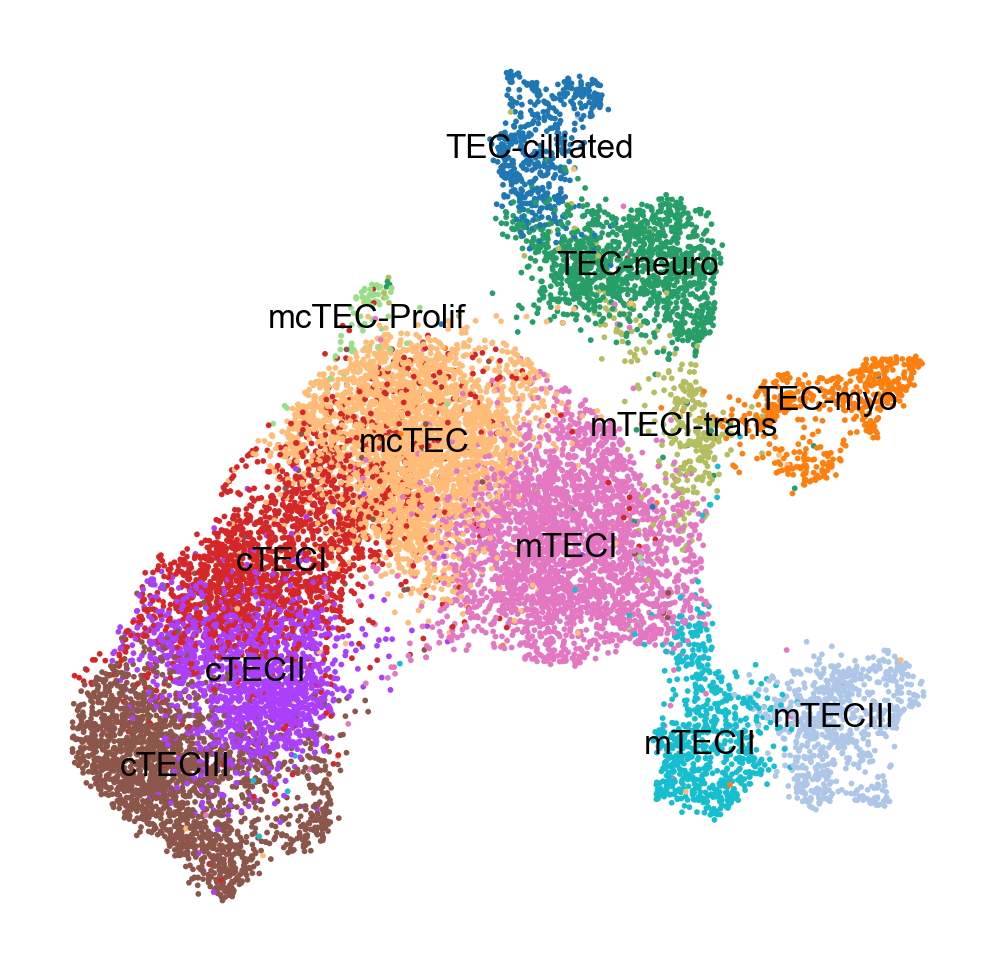

In [43]:
sc.pl.umap(adata_paed_scvi[adata_paed_scvi.obs['cell_type_level_4_explore']!='TEC-tuft'], color = ['cell_type_level_4_explore'], legend_loc = "on data", legend_fontsize = 8, 
           title = "", frameon = False, save = "TEC_paediatric_UMAP.pdf")

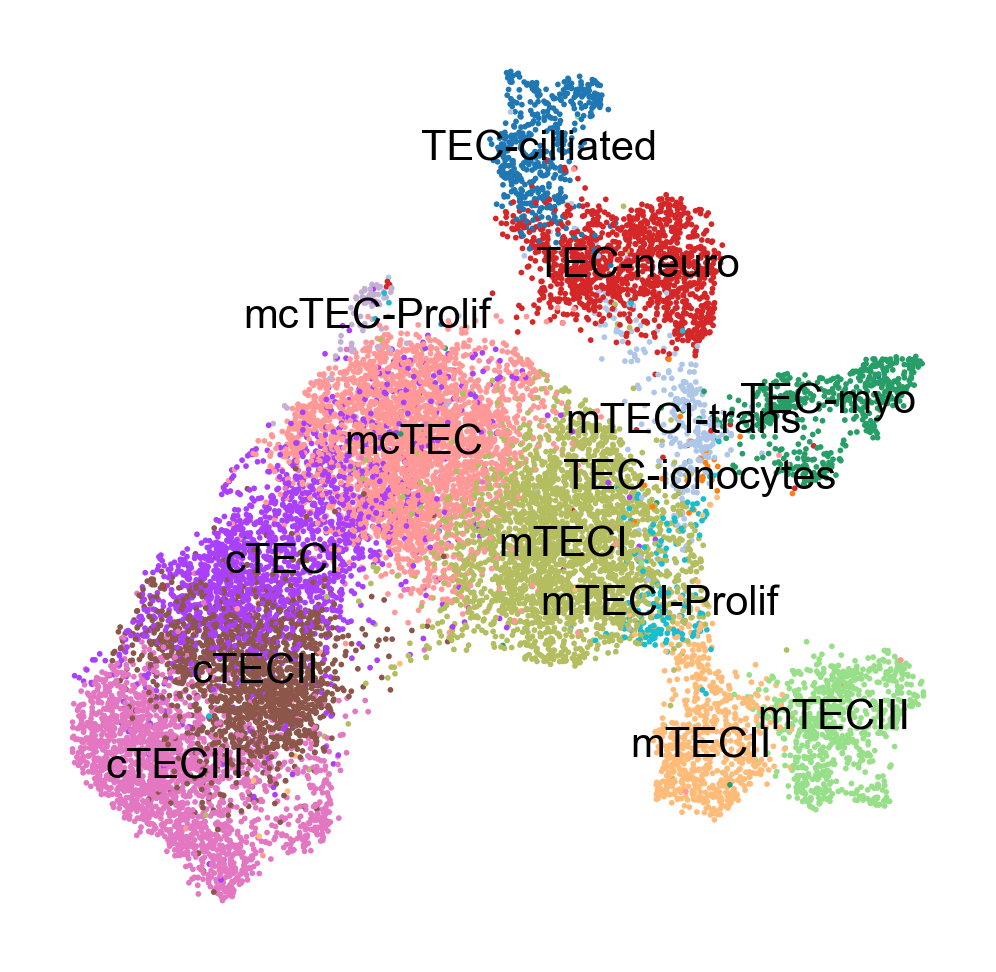

In [45]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd'], legend_loc = "on data", legend_fontsize = 10, 
           title = "", frameon = False, save = "mcTEC_paediatric_mcTEC_join.pdf")

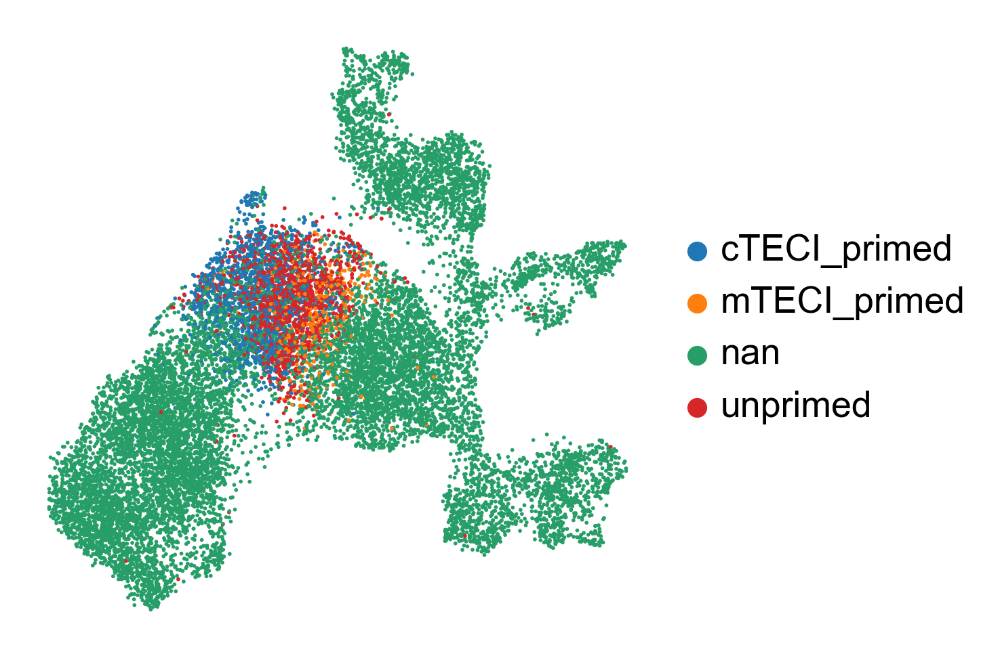

In [25]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd3'], 
           title = "", frameon = False)

In [26]:
adata_paed_scvi.obs['cell_type_level_4_upd3'].cat.reorder_categories(['cTECI_primed', 'mTECI_primed', 
                                                                     'unprimed', 'nan'], inplace = True)

In [27]:
adata_paed_scvi.uns['cell_type_level_4_upd3_colors'] = ["#D55E00",                                                        
"#F0E442",
"#0072B2", "lightgray"]

In [31]:
import os
os.getcwd()

'/nfs/team205/ny1/ThymusSpatialAtlas/software/ImageSpot'

In [33]:
os.chdir('/nfs/team205/ny1/ThymusSpatialAtlas/')

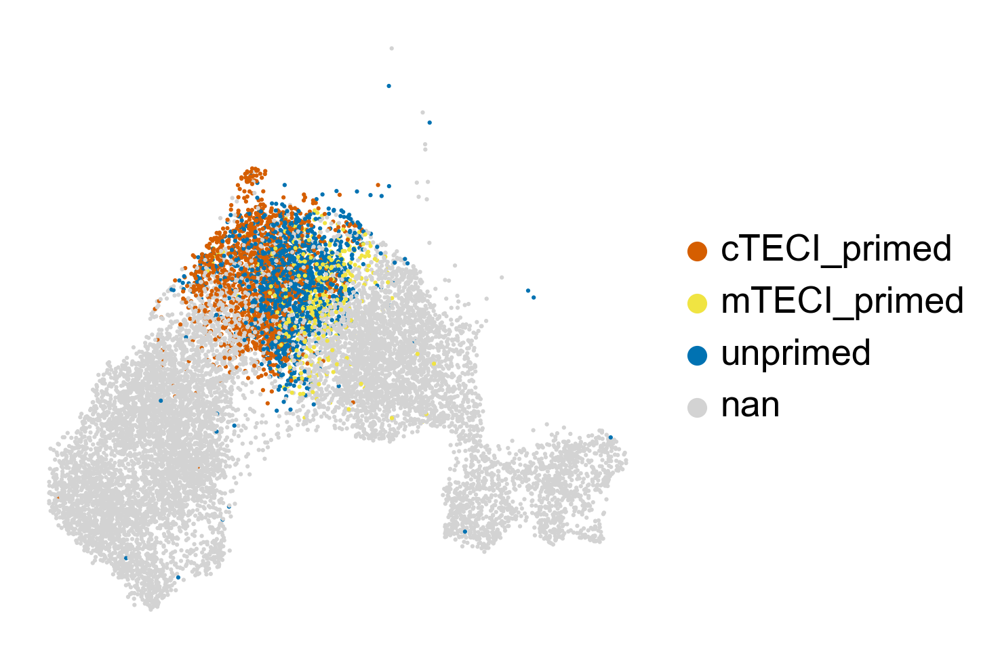

In [34]:
sc.pl.umap(adata_paed_scvi[~adata_paed_scvi.obs['cell_type_level_4_explore'].isin(['mTECI-trans', 'TEC-neuro', 'TEC-cilliated',
       'TEC-myo', 'TEC-tuft'])], color = ['cell_type_level_4_upd3'], 
           title = "", frameon = False, save = "mcTEC_paediatric_highlight_colorblind_v2.pdf")

In [56]:
adata_paed_scvi.uns['cell_type_level_4_upd3_colors'] = ['#1f77b4', '#ff7f0e', '#279e68', '#d62728', '#aa40fc', '#8c564b',
       '#e377c2', '#b5bd61', '#17becf', '#aec7e8', '#ffbb78', '#98df8a',
       '#c5b0d5',
"#D55E00",                                                        
"#F0E442", #"#51ba99",# "#5973d2", #"#c493d3",#"#b65779", #"#c97464",#"#d14142", # "#da3e7f", #"#c97464",
"#0072B2"] #"#d0a444"]#"#da3e7f"]# "#d0a444"] #"#8a823c"]

In [53]:
enumerated_ctypes = enumerate(adata_paed_scvi.obs['cell_type_level_4_upd3'].cat.categories)

In [54]:
print(list(enumerated_ctypes))

[(0, 'TEC-cilliated'), (1, 'TEC-ionocytes'), (2, 'TEC-myo'), (3, 'TEC-neuro'), (4, 'cTECI'), (5, 'cTECII'), (6, 'cTECIII'), (7, 'mTECI'), (8, 'mTECI-Prolif'), (9, 'mTECI-trans'), (10, 'mTECII'), (11, 'mTECIII'), (12, 'mcTEC-Prolif'), (13, 'mcTEC_cTECI-primed'), (14, 'mcTEC_mTECI-primed'), (15, 'mcTEC_unprimed')]


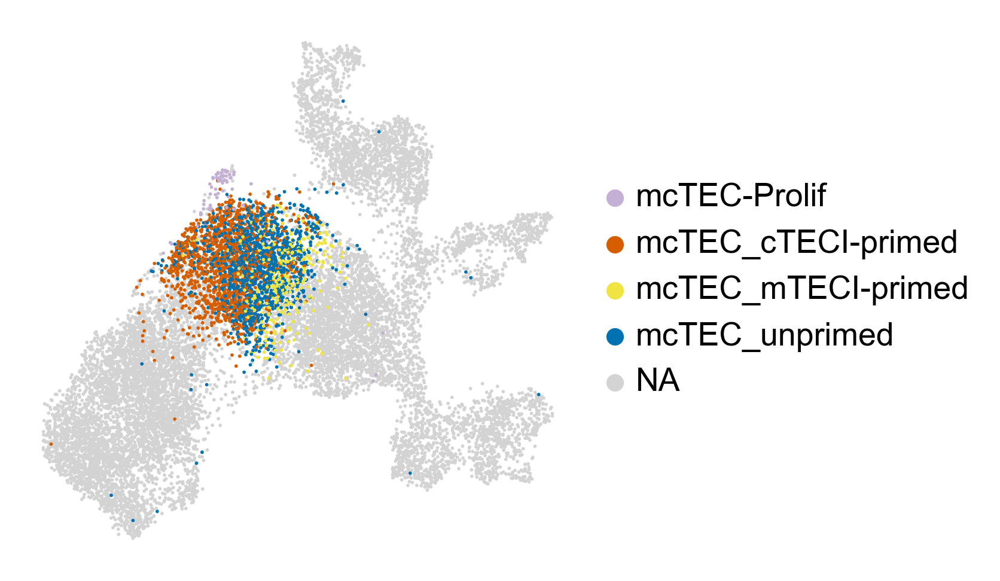

In [57]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd3'], groups = ['mcTEC-Prolif', 'mcTEC_cTECI-primed', 'mcTEC_unprimed',
       'mcTEC_mTECI-primed'], 
           title = "", frameon = False, save = "mcTEC_paediatric_highlight_colorblind.pdf")

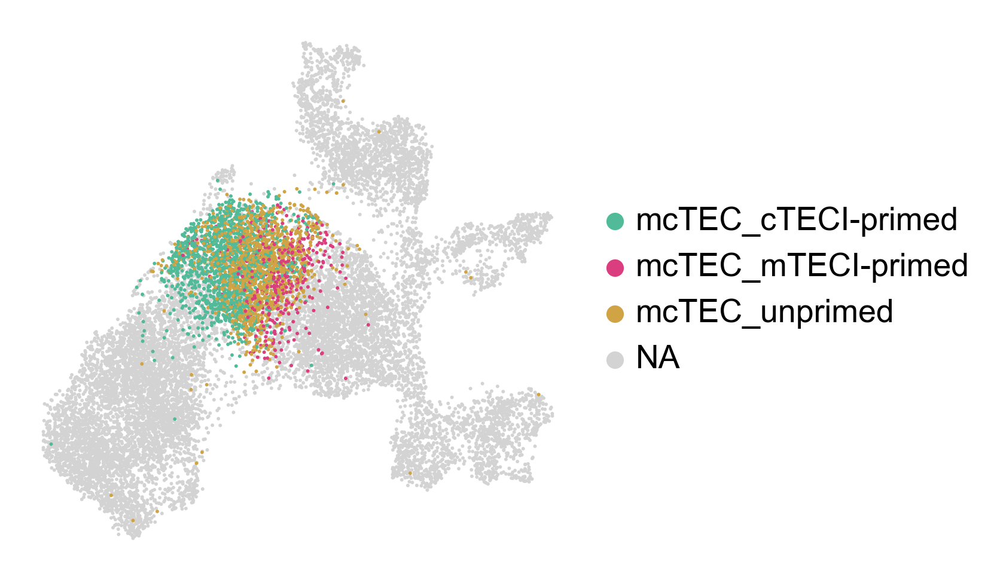

In [46]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd3'], groups = ['mcTEC_cTECI-primed', 'mcTEC_unprimed',
       'mcTEC_mTECI-primed'], 
           title = "", frameon = False, s=8, save = "mcTEC_paediatric_highlight_color2.pdf")

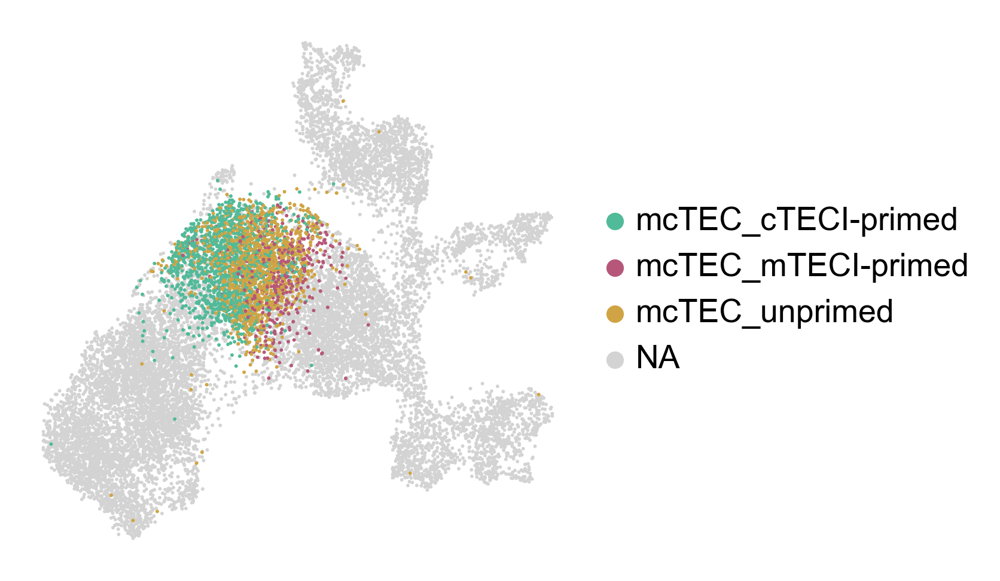

In [58]:
sc.pl.umap(adata_paed_scvi, color = ['cell_type_level_4_upd3'], groups = ['mcTEC_cTECI-primed', 'mcTEC_unprimed',
       'mcTEC_mTECI-primed'], 
           title = "", frameon = False, s=8, save = "mcTEC_paediatric_highlight_color3.pdf")

In [16]:
celltypes2show = ['cTECIII','cTECII','cTECI','mcTEC_cTECI-primed', 'mcTEC_unprimed',
       'mcTEC_mTECI-primed', 'mTECI','mTECII','mTECIII']

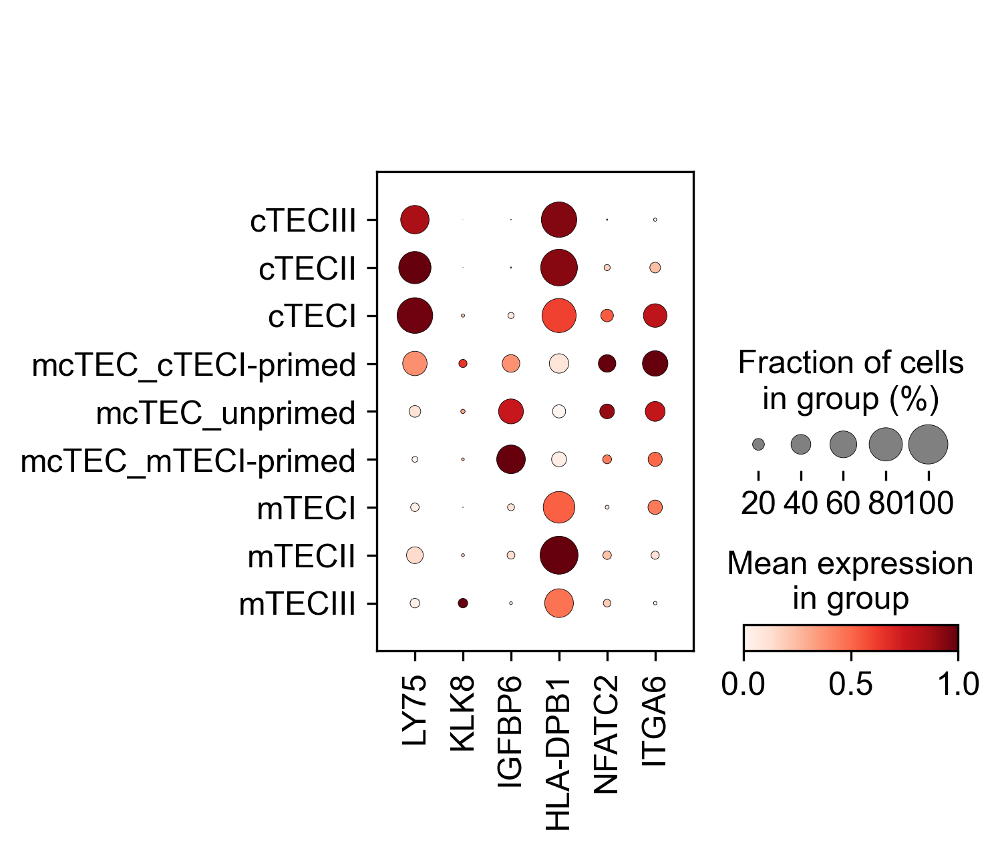

In [21]:
sc.pl.dotplot(adata_paed_scvi[adata_paed_scvi.obs['cell_type_level_4_upd3'].isin(celltypes2show),:], 
              groupby = ['cell_type_level_4_upd3'], var_names =  ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"],
              categories_order = celltypes2show, standard_scale = 'var', save = "mcTEC_paediatric_markers_full_context.pdf")

In [22]:
celltypes2show_filt = ['cTECI','mcTEC_cTECI-primed', 'mcTEC_unprimed',
       'mcTEC_mTECI-primed', 'mTECI']

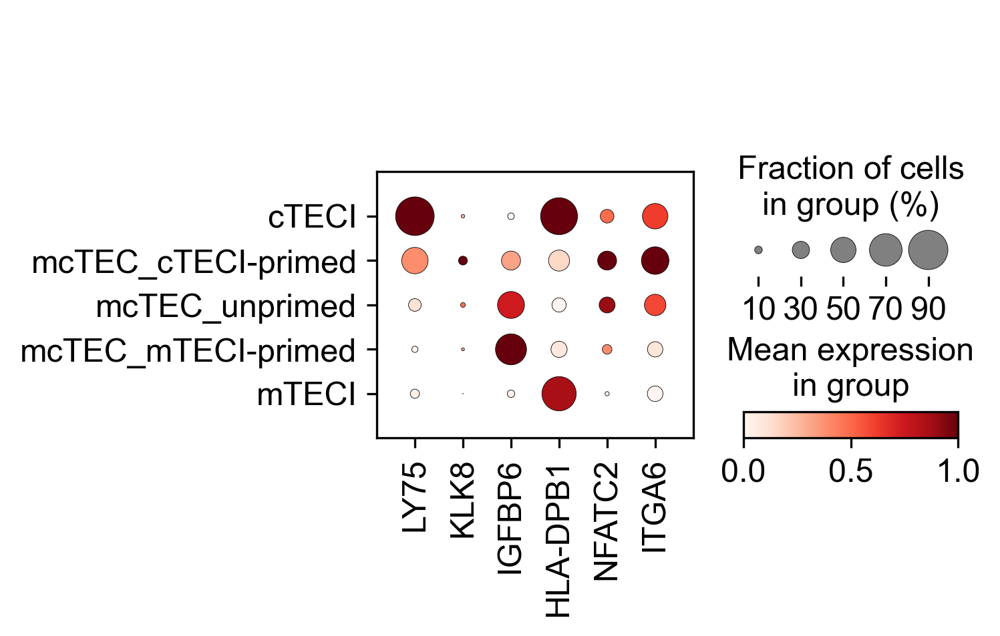

In [23]:
sc.pl.dotplot(adata_paed_scvi[adata_paed_scvi.obs['cell_type_level_4_upd3'].isin(celltypes2show_filt),:], 
              groupby = ['cell_type_level_4_upd3'], var_names =  ["LY75", "KLK8", "IGFBP6", "HLA-DPB1", "NFATC2", "ITGA6"],
              categories_order = celltypes2show_filt, standard_scale = 'var', save = "mcTEC_paediatric_markers_filt_context.pdf")